# Uber Pickups Project

**Importing Standard Librairies**

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import configparser as cp

from sklearn.cluster import MiniBatchKMeans

from bokeh.io import output_file, show, output_notebook
from bokeh.models import ColumnDataSource, GMapOptions
from bokeh.plotting import gmap

**Data Exploration**

In [2]:
df = pd.read_csv('./Datasets/uber-raw-data-apr14.csv', infer_datetime_format=True, parse_dates=[0]) 

In [3]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Date/Time  564516 non-null  datetime64[ns]
 1   Lat        564516 non-null  float64       
 2   Lon        564516 non-null  float64       
 3   Base       564516 non-null  object        
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 17.2+ MB


In [5]:
df.describe(include='all')

,Date/Time,Lat,Lon,Base
count,564516,564516.000000,564516.000000,564516
unique,41999,NaN,NaN,5
top,2014-04-07 20:21:00,NaN,NaN,B02682
freq,97,NaN,NaN,227808
first,2014-04-01 00:00:00,NaN,NaN,NaN
last,2014-04-30 23:59:00,NaN,NaN,NaN
mean,NaN,40.740005,-73.976817,NaN
std,NaN,0.036083,0.050426,NaN
min,NaN,40.072900,-74.773300,NaN
25%,NaN,40.722500,-73.997700,NaN


# Data preparation

**Dividing Dataset into 7 Dataset (one for each day of the week)**

In [6]:
df.shape

(564516, 4)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Date/Time  564516 non-null  datetime64[ns]
 1   Lat        564516 non-null  float64       
 2   Lon        564516 non-null  float64       
 3   Base       564516 non-null  object        
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 17.2+ MB


In [8]:
from tqdm import tqdm
tqdm.pandas()

In [9]:
df['weekday'] = df['Date/Time'].dt.dayofweek

In [10]:
df.head()

,Date/Time,Lat,Lon,Base,weekday
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1


In [11]:
df.weekday.unique()

array([1, 2, 3, 4, 5, 6, 0])

In [12]:
df[df['weekday'] == 0]

,Date/Time,Lat,Lon,Base,weekday
7785,2014-04-07 00:31:00,40.7205,-73.9939,B02512,0
7786,2014-04-07 00:37:00,40.7407,-74.0077,B02512,0
7787,2014-04-07 00:50:00,40.7591,-73.9892,B02512,0
7788,2014-04-07 00:58:00,40.7419,-74.0034,B02512,0
7789,2014-04-07 01:27:00,40.7419,-74.0034,B02512,0
...,...,...,...,...,...
563519,2014-04-28 23:17:00,40.7732,-73.9483,B02764,0
563520,2014-04-28 23:23:00,40.7091,-74.0111,B02764,0
563521,2014-04-28 23:35:00,40.7197,-73.9949,B02764,0
563522,2014-04-28 23:40:00,40.6850,-73.9089,B02764,0


In [13]:
monday = df[df['weekday'] == 0]
tuesday = df[df['weekday'] == 1]
wednesday = df[df['weekday'] == 2]
thursday = df[df['weekday'] == 3]
friday = df[df['weekday'] == 4]
saturday = df[df['weekday'] == 5]
sunday = df[df['weekday'] == 6]

# Monday

**API Key Parameter**

In [113]:
# Config parser
config = cp.ConfigParser()
config.read('config.ini')

['config.ini']

In [114]:
key = config.get('AUTH', 'key')
ra_key = config.get('AUTH', 'ra_key')

In [115]:
X_mon = monday[['Lat','Lon']]

kmeans_mon = MiniBatchKMeans(n_clusters=9)
kmeans_mon.fit(X_mon)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=9, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [116]:
output_file('./html/monday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(ra_key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_mon.cluster_centers_[:,0],
                                      lon=kmeans_mon.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 0].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 1].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 2].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 3].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 4].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 5].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 5].iloc[:,1]))

cluster_7 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 6].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 6].iloc[:,1]))
cluster_8 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 7].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 7].iloc[:,1]))
cluster_9 = ColumnDataSource(data=dict(lat=X_mon[kmeans_mon.labels_== 8].iloc[:,0], lon=X_mon[kmeans_mon.labels_== 8].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)

p.circle(x="lon", y="lat", size=8, fill_color="chartreuse", fill_alpha=0.8, source=cluster_7)
p.circle(x="lon", y="lat", size=8, fill_color="chocolate", fill_alpha=0.8, source=cluster_8)
p.circle(x="lon", y="lat", size=8, fill_color="deepskyblue", fill_alpha=0.8, source=cluster_9)

p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Tuesday

In [75]:
X_tues = tuesday[['Lat','Lon']]

kmeans_tues = MiniBatchKMeans(n_clusters=6)
kmeans_tues.fit(X_tues)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=6, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [37]:
output_file('./html/tuesday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_tues.cluster_centers_[:,0],
                                      lon=kmeans_tues.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_tues[kmeans_tues.labels_== 0].iloc[:,0], lon=X_tues[kmeans_tues.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_tues[kmeans_tues.labels_== 1].iloc[:,0], lon=X_tues[kmeans_tues.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_tues[kmeans_tues.labels_== 2].iloc[:,0], lon=X_tues[kmeans_tues.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_tues[kmeans_tues.labels_== 3].iloc[:,0], lon=X_tues[kmeans_tues.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_tues[kmeans_tues.labels_== 4].iloc[:,0], lon=X_tues[kmeans_tues.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_tues[kmeans_tues.labels_== 5].iloc[:,0], lon=X_tues[kmeans_tues.labels_== 5].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)
p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Wednesday

In [76]:
X_wed = wednesday[['Lat','Lon']]

kmeans_wed = MiniBatchKMeans(n_clusters=6)
kmeans_wed.fit(X_wed)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=6, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [39]:
output_file('./html/wednesday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_wed.cluster_centers_[:,0],
                                      lon=kmeans_wed.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_wed[kmeans_wed.labels_== 0].iloc[:,0], lon=X_wed[kmeans_wed.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_wed[kmeans_wed.labels_== 1].iloc[:,0], lon=X_wed[kmeans_wed.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_wed[kmeans_wed.labels_== 2].iloc[:,0], lon=X_wed[kmeans_wed.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_wed[kmeans_wed.labels_== 3].iloc[:,0], lon=X_wed[kmeans_wed.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_wed[kmeans_wed.labels_== 4].iloc[:,0], lon=X_wed[kmeans_wed.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_wed[kmeans_wed.labels_== 5].iloc[:,0], lon=X_wed[kmeans_wed.labels_== 5].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)
p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Thursday

In [77]:
X_thur = thursday[['Lat','Lon']]

kmeans_thur = MiniBatchKMeans(n_clusters=6)
kmeans_thur.fit(X_thur)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=6, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [41]:
output_file('./html/thursday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_thur.cluster_centers_[:,0],
                                      lon=kmeans_thur.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_thur[kmeans_thur.labels_== 0].iloc[:,0], lon=X_thur[kmeans_thur.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_thur[kmeans_thur.labels_== 1].iloc[:,0], lon=X_thur[kmeans_thur.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_thur[kmeans_thur.labels_== 2].iloc[:,0], lon=X_thur[kmeans_thur.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_thur[kmeans_thur.labels_== 3].iloc[:,0], lon=X_thur[kmeans_thur.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_thur[kmeans_thur.labels_== 4].iloc[:,0], lon=X_thur[kmeans_thur.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_thur[kmeans_thur.labels_== 5].iloc[:,0], lon=X_thur[kmeans_thur.labels_== 5].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)
p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Friday

In [78]:
X_fri = friday[['Lat','Lon']]

kmeans_fri = MiniBatchKMeans(n_clusters=6)
kmeans_fri.fit(X_fri)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=6, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [43]:
output_file('./html/friday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_fri.cluster_centers_[:,0],
                                      lon=kmeans_fri.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_fri[kmeans_fri.labels_== 0].iloc[:,0], lon=X_fri[kmeans_fri.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_fri[kmeans_fri.labels_== 1].iloc[:,0], lon=X_fri[kmeans_fri.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_fri[kmeans_fri.labels_== 2].iloc[:,0], lon=X_fri[kmeans_fri.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_fri[kmeans_fri.labels_== 3].iloc[:,0], lon=X_fri[kmeans_fri.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_fri[kmeans_fri.labels_== 4].iloc[:,0], lon=X_fri[kmeans_fri.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_fri[kmeans_fri.labels_== 5].iloc[:,0], lon=X_fri[kmeans_fri.labels_== 5].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)
p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Saturday

In [79]:
X_sat = saturday[['Lat','Lon']]

kmeans_sat = MiniBatchKMeans(n_clusters=6)
kmeans_sat.fit(X_sat)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=6, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [45]:
output_file('./html/saturday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_sat.cluster_centers_[:,0],
                                      lon=kmeans_sat.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_sat[kmeans_sat.labels_== 0].iloc[:,0], lon=X_sat[kmeans_sat.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_sat[kmeans_sat.labels_== 1].iloc[:,0], lon=X_sat[kmeans_sat.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_sat[kmeans_sat.labels_== 2].iloc[:,0], lon=X_sat[kmeans_sat.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_sat[kmeans_sat.labels_== 3].iloc[:,0], lon=X_sat[kmeans_sat.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_sat[kmeans_sat.labels_== 4].iloc[:,0], lon=X_sat[kmeans_sat.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_sat[kmeans_sat.labels_== 5].iloc[:,0], lon=X_sat[kmeans_sat.labels_== 5].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)
p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Sunday

In [80]:
X_sun = sunday[['Lat','Lon']]

kmeans_sun = MiniBatchKMeans(n_clusters=6)
kmeans_sun.fit(X_sun)

MiniBatchKMeans(batch_size=100, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=6, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [47]:
output_file('./html/sunday.html')

map_options = GMapOptions(lat=40.7128, lng=-74.0060, map_type="roadmap", zoom=10)

p = gmap(key, map_options, title="New York")

centroid = ColumnDataSource(data=dict(lat=kmeans_sun.cluster_centers_[:,0],
                                      lon=kmeans_sun.cluster_centers_[:,1]))

cluster_1 = ColumnDataSource(data=dict(lat=X_sun[kmeans_sun.labels_== 0].iloc[:,0], lon=X_sun[kmeans_sun.labels_== 0].iloc[:,1]))
cluster_2 = ColumnDataSource(data=dict(lat=X_sun[kmeans_sun.labels_== 1].iloc[:,0], lon=X_sun[kmeans_sun.labels_== 1].iloc[:,1]))
cluster_3 = ColumnDataSource(data=dict(lat=X_sun[kmeans_sun.labels_== 2].iloc[:,0], lon=X_sun[kmeans_sun.labels_== 2].iloc[:,1]))
cluster_4 = ColumnDataSource(data=dict(lat=X_sun[kmeans_sun.labels_== 3].iloc[:,0], lon=X_sun[kmeans_sun.labels_== 3].iloc[:,1]))
cluster_5 = ColumnDataSource(data=dict(lat=X_sun[kmeans_sun.labels_== 4].iloc[:,0], lon=X_sun[kmeans_sun.labels_== 4].iloc[:,1]))
cluster_6 = ColumnDataSource(data=dict(lat=X_sun[kmeans_sun.labels_== 5].iloc[:,0], lon=X_sun[kmeans_sun.labels_== 5].iloc[:,1]))

p.circle(x="lon", y="lat", size=8, fill_color="red", fill_alpha=0.8, source=cluster_1)
p.circle(x="lon", y="lat", size=8, fill_color="green", fill_alpha=0.8, source=cluster_2)
p.circle(x="lon", y="lat", size=8, fill_color="yellow", fill_alpha=0.8, source=cluster_3)
p.circle(x="lon", y="lat", size=8, fill_color="blue", fill_alpha=0.8, source=cluster_4)
p.circle(x="lon", y="lat", size=8, fill_color="magenta", fill_alpha=0.8, source=cluster_5)
p.circle(x="lon", y="lat", size=8, fill_color="white", fill_alpha=0.8, source=cluster_6)
p.circle(x="lon", y="lat", size=15, fill_color="black", fill_alpha=0.8, source=centroid)

show(p)

# Elbow Method 

**Monday**

In [81]:
inertias_mon = []

for k in range(4, 12):
  km_mon_elbow = MiniBatchKMeans(n_clusters=k)
  km_mon_elbow.fit(X_mon)
  inertias_mon.append(km_mon_elbow.inertia_)

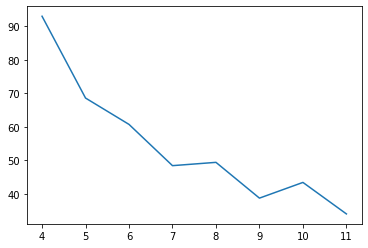

In [82]:
sns.lineplot(x=range(4, 12), y=inertias_mon)

**Tuesday**

In [83]:
inertias_tues = []

for k in range(4, 12):
  km_tues_elbow = MiniBatchKMeans(n_clusters=k)
  km_tues_elbow.fit(X_tues)
  inertias_tues.append(km_tues_elbow.inertia_)

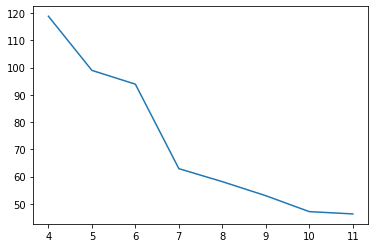

In [84]:
sns.lineplot(x=range(4, 12), y=inertias_tues)

**Wednesday**

In [111]:
inertias_wed = []

for k in range(4, 14):
  km_wed_elbow = MiniBatchKMeans(n_clusters=k)
  km_wed_elbow.fit(X_wed)
  inertias_wed.append(km_wed_elbow.inertia_)

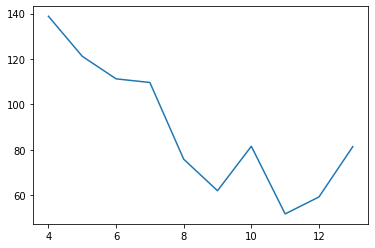

In [112]:
sns.lineplot(x=range(4, 14), y=inertias_wed)

**Thursday**

In [87]:
inertias_thur = []

for k in range(4, 12):
  km_thur_elbow = MiniBatchKMeans(n_clusters=k)
  km_thur_elbow.fit(X_thur)
  inertias_thur.append(km_thur_elbow.inertia_)

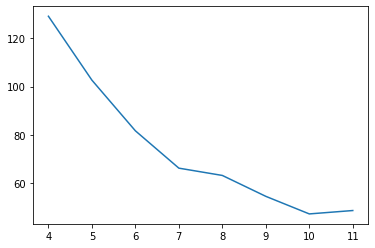

In [88]:
sns.lineplot(x=range(4, 12), y=inertias_thur)

**Friday**

In [107]:
inertias_fri = []

for k in range(4, 15):
  km_fri_elbow = MiniBatchKMeans(n_clusters=k)
  km_fri_elbow.fit(X_fri)
  inertias_fri.append(km_fri_elbow.inertia_)

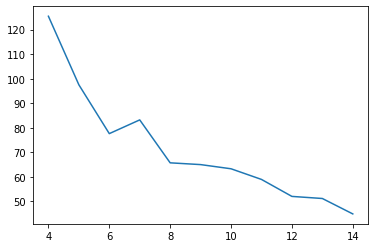

In [108]:
sns.lineplot(x=range(4, 15), y=inertias_fri)

**Saturday**

In [105]:
inertias_sat = []

for k in range(4, 15):
  km_sat_elbow = MiniBatchKMeans(n_clusters=k)
  km_sat_elbow.fit(X_sat)
  inertias_sat.append(km_sat_elbow.inertia_)

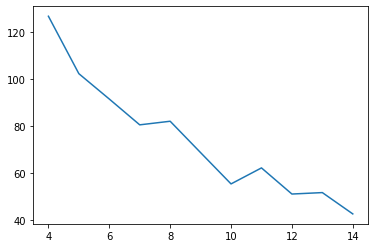

In [106]:
sns.lineplot(x=range(4, 15), y=inertias_sat)

**Sunday**

In [97]:
inertias_sun = []

for k in range(4, 12):
  km_sun_elbow = MiniBatchKMeans(n_clusters=k)
  km_sun_elbow.fit(X_sun)
  inertias_sun.append(km_sun_elbow.inertia_)

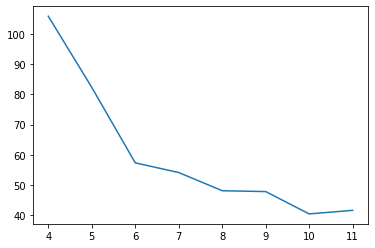

In [100]:
sns.lineplot(x=range(4, 12), y=inertias_sun)

# Silhouette Method

**Only for day with trouble with elbow method**

**Wednesday**

For n_clusters = 8, silhouette score is 0.3166499666677416)
For n_clusters = 9, silhouette score is 0.3416375377020575)
For n_clusters = 10, silhouette score is 0.38179273937262015)
For n_clusters = 11, silhouette score is 0.3153254219741464)
For n_clusters = 12, silhouette score is 0.38394746932981233)


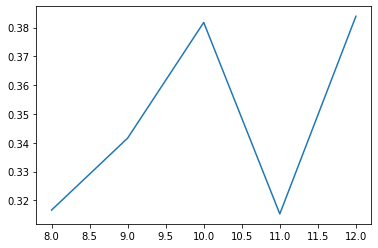

In [121]:
from sklearn.metrics import silhouette_score

sil_score = []

for n_clusters in range(8, 13):
    clusterer = MiniBatchKMeans(n_clusters=n_clusters)
    clusterer.fit(X_wed)
    score = silhouette_score(X_wed, clusterer.labels_)
    print("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))
    sil_score.append(score)

sns.lineplot(x=range(8, 13), y=sil_score)

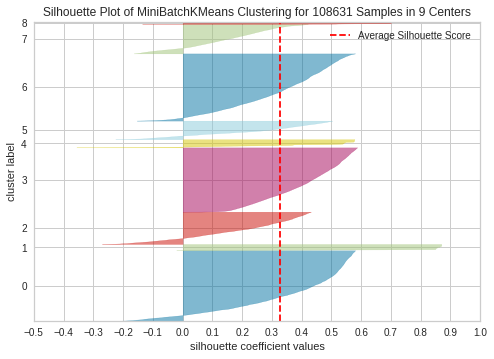

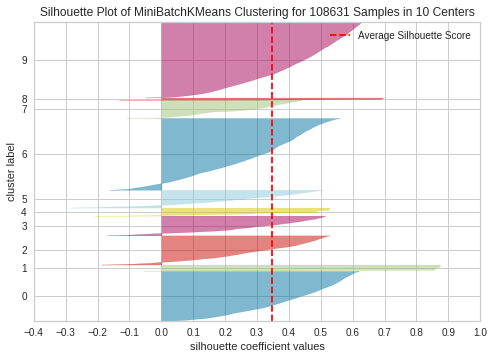

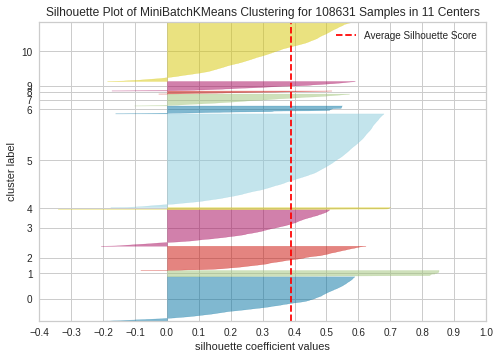

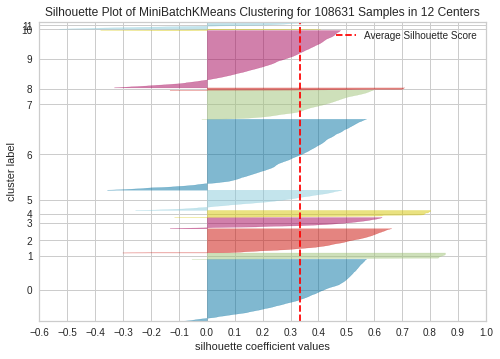

In [122]:
from yellowbrick.cluster import silhouette_visualizer
for i in [9, 10, 11, 12]:
    silhouette_visualizer(MiniBatchKMeans(i, random_state=42), X_wed, colors='yellowbrick')

**Saturday**

100%|██████████| 4/4 [05:15<00:00, 78.96s/it]For n_clusters = 13, silhouette score is 0.3447204690117299)



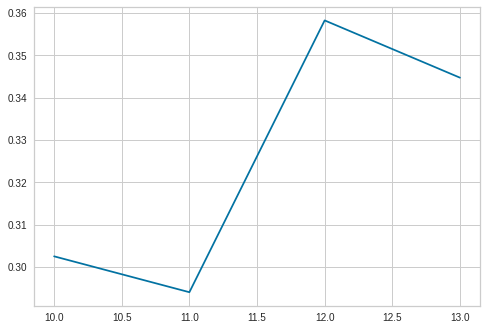

In [125]:
from sklearn.metrics import silhouette_score

sil_score = []

for n_clusters in tqdm(range(10, 14)):
    clusterer = MiniBatchKMeans(n_clusters=n_clusters)
    clusterer.fit(X_sat)
    score = silhouette_score(X_sat, clusterer.labels_)
    print("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))
    sil_score.append(score)

sns.lineplot(x=range(10, 14), y=sil_score)

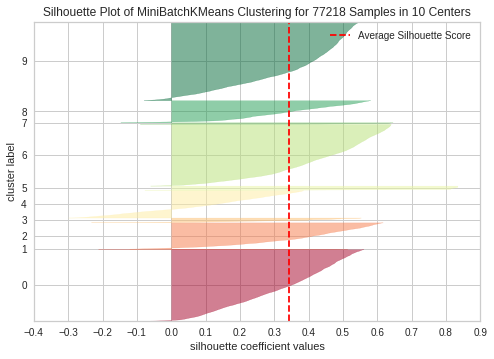

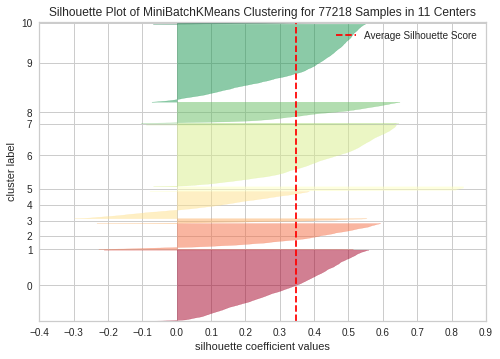

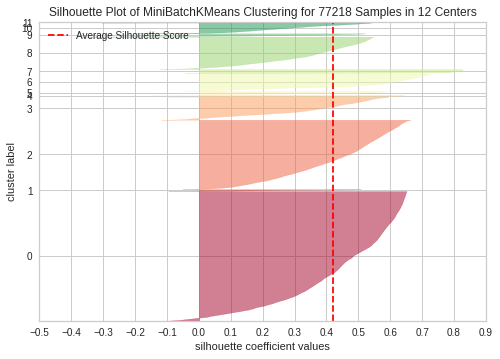

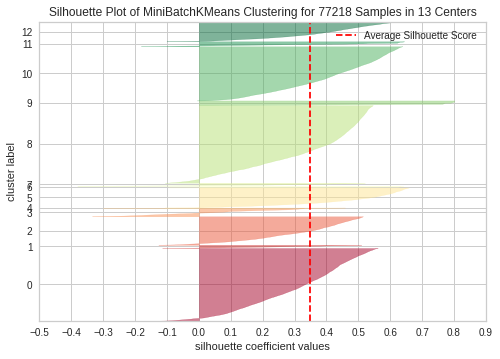

In [126]:
for i in [10, 11, 12, 13]:
    silhouette_visualizer(MiniBatchKMeans(i, random_state=42), X_sat, colors='RdYlGn')